In [40]:
# Importando as bibliotecas necessárias
import pandas as pd

import folium
from folium.plugins import HeatMap

import matplotlib.pyplot as plt

In [41]:
# Importando a tabela com os dados 

df = pd.read_csv(r"C:\Users\Pradolux\Downloads\Acidentes POA\cat_acidentes.csv", sep=";")
df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2024-09-01 01:32:36,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000e+00,0.000000e+00,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2024-09-01 01:32:36,6699.0,0.0,2019-01-01 00:00:00,1,0,0,0,0,3,...,-8.178406e+08,1.295680e+09,AV ASSIS BRASIL,NaN,ABALROAMENTO,TERÇA-FEIRA,02:45:00.0000000,NOITE,NORTE,NaN
2,2024-09-01 01:32:36,411.0,0.0,2019-01-01 00:00:00,1,0,0,0,0,2,...,-8.267608e+08,1.292030e+09,R DR BARROS CASSAL,NaN,ABALROAMENTO,TERÇA-FEIRA,07:36:00.0000000,DIA,CENTRO,NaN
3,2024-09-01 01:32:36,1500.0,0.0,2019-01-01 00:00:00,4,2,0,0,0,1,...,-8.272275e+08,1.285404e+09,AV FABIO ARAUJO SANTOS,NaN,CHOQUE,TERÇA-FEIRA,16:50:00.0000000,DIA,SUL,NaN
4,2024-09-01 01:32:36,8799.0,0.0,2019-01-01 00:00:00,5,0,0,0,0,3,...,-8.201465e+08,1.288712e+09,AV IPIRANGA,NaN,COLISÃO,TERÇA-FEIRA,19:00:00.0000000,NOITE,LESTE,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72944,2024-09-01 01:32:36,377.0,0.0,2024-08-24 00:00:00,2,0,0,0,0,1,...,-5.112389e+01,-3.002318e+01,AV DEZ DE MAIO,NaN,COLISÃO,SÁBADO,23:15:00.0000000,NOITE,NORTE,NaN
72945,2024-09-01 01:32:36,1373.0,0.0,2024-08-24 00:00:00,1,0,0,0,0,1,...,-5.115155e+01,-3.002278e+01,AV FORTE,NaN,NAO CADASTRADO,SÁBADO,23:40:00.0000000,NOITE,NORTE,NaN
72946,2024-09-01 01:32:36,766.0,0.0,2024-08-25 00:00:00,1,0,0,0,0,1,...,-5.121469e+01,-3.007395e+01,R SEPE TIARAJU,NaN,ABALROAMENTO,DOMINGO,02:15:00.0000000,NOITE,SUL,NaN
72947,2024-09-01 01:32:36,4149.0,0.0,2024-08-25 00:00:00,0,0,0,0,0,1,...,-5.117043e+01,-3.004089e+01,AV PROTASIO ALVES,NaN,CHOQUE,DOMINGO,05:08:00.0000000,NOITE,LESTE,NaN


In [42]:
# Removendo as linhas que contem valores nulos para a latitude e longitude

df = df.dropna(subset=['latitude', 'longitude'], how='any')
df.isnull().sum()

data_extracao        0
predial1          2338
queda_arr            0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
onibus_int           0
caminhao             0
moto                 0
carroca              0
bicicleta            0
outro                0
cont_vit             0
ups                  0
patinete             0
idacidente           0
longitude            0
latitude             0
log1                36
log2             44990
tipo_acid            0
dia_sem              0
hora               421
noite_dia            0
regiao               0
consorcio        60662
dtype: int64

In [43]:
# Utilizando a Longitude a Latitude para fazer um mapa de calor aonde contém a maior taxa de acidentes

mapa = folium.Map(location=[-30.1 , -51.15], zoom_start=11)

coordenadas = list(zip(df.latitude, df.longitude))
mapa_calor = HeatMap(coordenadas, radius=9, blur=10)
mapa.add_child(mapa_calor)

mapa

In [44]:
# Mostrando uma mapa que mostra a quantidade de acidentes em cada região

from folium.plugins import MarkerCluster

mapa = folium.Map(location=[-30.1 , -51.15], zoom_start=11)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)

mapa

In [45]:
# Verificando os tipos dos dados 
df.dtypes

data_extracao     object
predial1         float64
queda_arr        float64
data              object
feridos            int64
feridos_gr         int64
mortes             int64
morte_post         int64
fatais             int64
auto               int64
taxi               int64
lotacao            int64
onibus_urb         int64
onibus_met         int64
onibus_int         int64
caminhao           int64
moto               int64
carroca            int64
bicicleta          int64
outro              int64
cont_vit           int64
ups                int64
patinete           int64
idacidente         int64
longitude        float64
latitude         float64
log1              object
log2              object
tipo_acid         object
dia_sem           object
hora              object
noite_dia         object
regiao            object
consorcio         object
dtype: object

In [46]:
# Convertendo a coluna data para o tipo datetime

df['data'] = pd.to_datetime(df['data'], errors='coerce')
df_ano = df['data'].dt.year.value_counts()
df_ano

C:\Users\Pradolux\AppData\Local\Temp\ipykernel_17232\476492171.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['data'] = pd.to_datetime(df['data'], errors='coerce')


data
2023    14569
2022    13326
2019    12444
2021    11700
2024     7807
2020     2896
2202        1
Name: count, dtype: int64

In [47]:
# Dropando o valor do ano incorreto

df_ano = df_ano.drop(2202)
df_ano

data
2023    14569
2022    13326
2019    12444
2021    11700
2024     7807
2020     2896
Name: count, dtype: int64

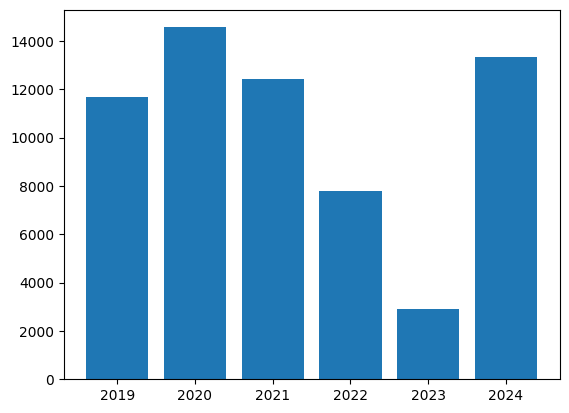

In [49]:
# Mostrando a quantidade de acidentes por ano

plt.bar(df_ano.index, df_ano.sort_values(ascending=True))
plt.show()

In [50]:
# Verificando a proporcao de acidentes pelo ultimo ano

df_ano / df_ano.max()

data
2023    1.000000
2022    0.914682
2019    0.854142
2021    0.803075
2024    0.535864
2020    0.198778
Name: count, dtype: float64

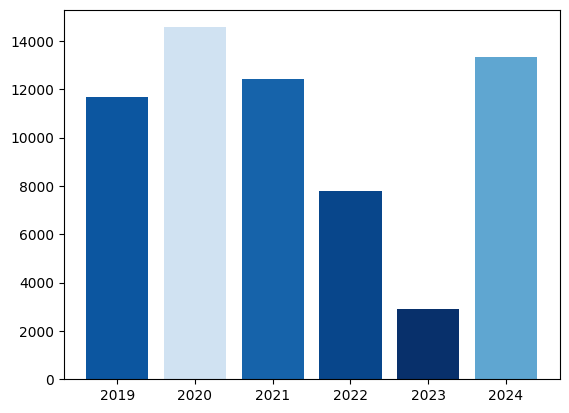

In [51]:
# Criar um gradiente de cores baseados com a informação a cima 

gradiente = df_ano / df_ano.max()

cores = plt.cm.Blues(gradiente)

plt.bar(df_ano.index, df_ano.sort_values(ascending=True), color = cores)
plt.show()